# Dolce

A little scratchpad to work with ideas before implementing them in frontend code.

In [1]:
from prisma import Prisma
db = Prisma()
db.connect()

In [4]:
db.show.find_many(take=10)

[Show(id=1, createdAt=datetime.datetime(2023, 7, 30, 8, 23, 48, 436000, tzinfo=datetime.timezone.utc), updatedAt=datetime.datetime(2023, 7, 30, 8, 23, 48, 436000, tzinfo=datetime.timezone.utc), name='Stein SPRING 2024 WOMAN RTW TOKYO', url='https://www.vogue.com/fashion-shows/tokyo-spring-2024/stein', sex='WOMAN', level='RTW', description=None, articlesConsensus=None, articles=None, reviewsConsensus=None, reviews=None, video=None, videoId=None, season=None, seasonId=1, date=datetime.datetime(2023, 7, 24, 6, 0, tzinfo=datetime.timezone.utc), location='TOKYO', collections=None, looks=None, brand=None, brandId=1),
 Show(id=2, createdAt=datetime.datetime(2023, 7, 30, 8, 23, 48, 608000, tzinfo=datetime.timezone.utc), updatedAt=datetime.datetime(2023, 7, 30, 8, 23, 48, 608000, tzinfo=datetime.timezone.utc), name='Ryunosukeokazaki SPRING 2024 WOMAN RTW TOKYO', url='https://www.vogue.com/fashion-shows/tokyo-spring-2024/ryunosukeokazaki', sex='WOMAN', level='RTW', description=None, articlesCons

In [46]:
posts = db.post.find_many(take=10, include={'images': True})

TableNotFoundError: The table `public.Post` does not exist in the current database.

In [47]:
import json


dir = "../scripts/node/save"

items = []

for i in range(2, 5):
    filename = f"{dir}/posts{i}.json"
    print(f"Loading items from {filename}")
    with open(filename) as f:
        d = json.load(f)
        items = items + d["items"]

print(f"Loaded {len(items)} items")

Loading items from ../scripts/node/save/posts2.json
Loading items from ../scripts/node/save/posts3.json
Loading items from ../scripts/node/save/posts4.json
Loaded 63 items


In [82]:
for key in d:
    print(key)

d[""]

items
num_results
more_available
auto_load_more_enabled
next_max_id
status


21

In [55]:
items[0]["media"]["id"]
items[0]["image"]

KeyError: 'image'

In [58]:
import requests
from IPython.display import Image
from IPython.core.display import HTML

for item in items:
    media = item["media"]
    image = media["image_versions2"]["candidates"][0]
    id = media["id"]
    filename = f"{id}.jpg"
    res = requests.get(image["url"])
    with open(filename, "wb") as f:
        f.write(res.content)
    item["image"] = Image(data=filename, width=250)

In [63]:
for item in items:
    id = item["media"]["id"]
    item["image_file"] = f"{id}.jpg"

In [74]:
images = [item["image"] for item in items]
items[2]["image_file"]

'3237854790251596074_58199897179.jpg'

In [75]:
from ipywidgets import widgets, HBox
from IPython.display import display


hbox = HBox([widgets.Image(value=open(item["image_file"], "rb").read()) for item in items])
display(hbox)

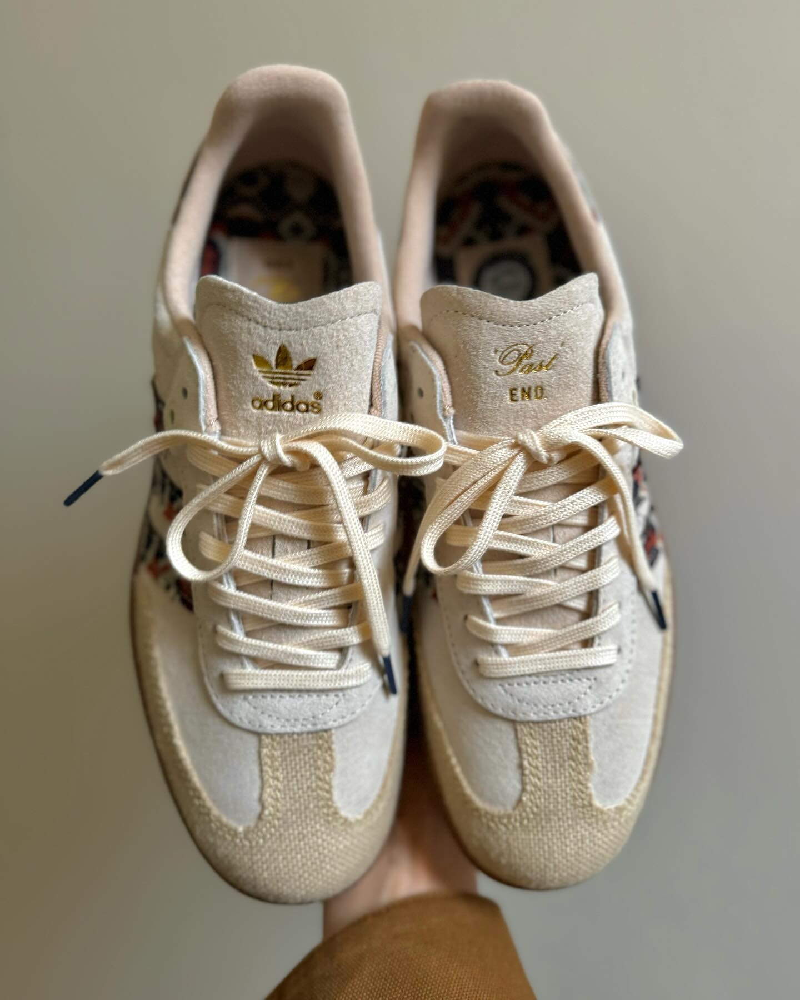

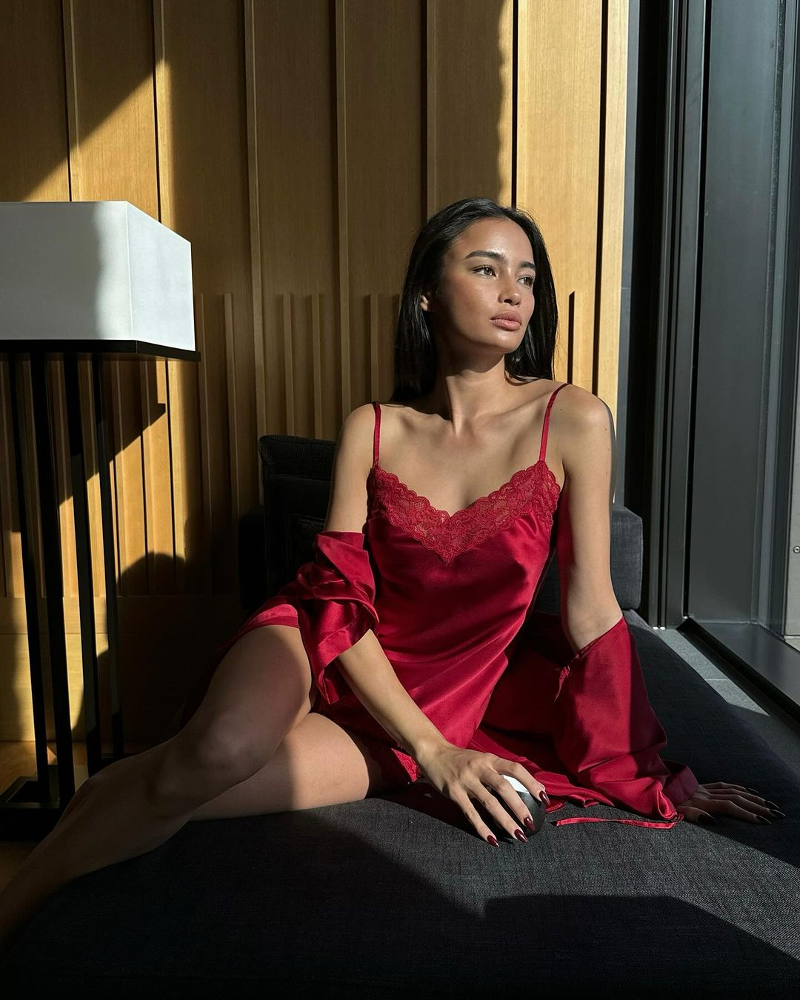

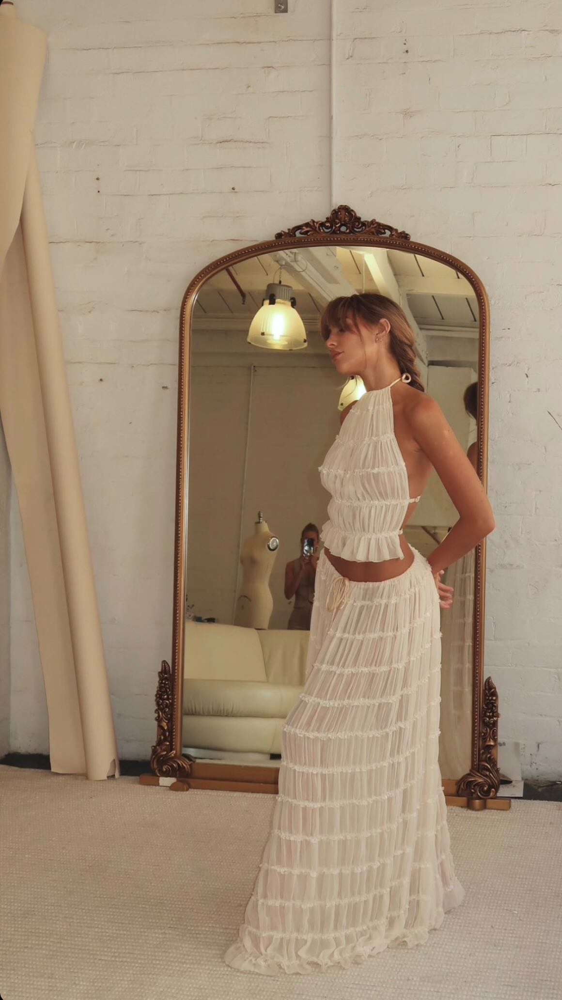

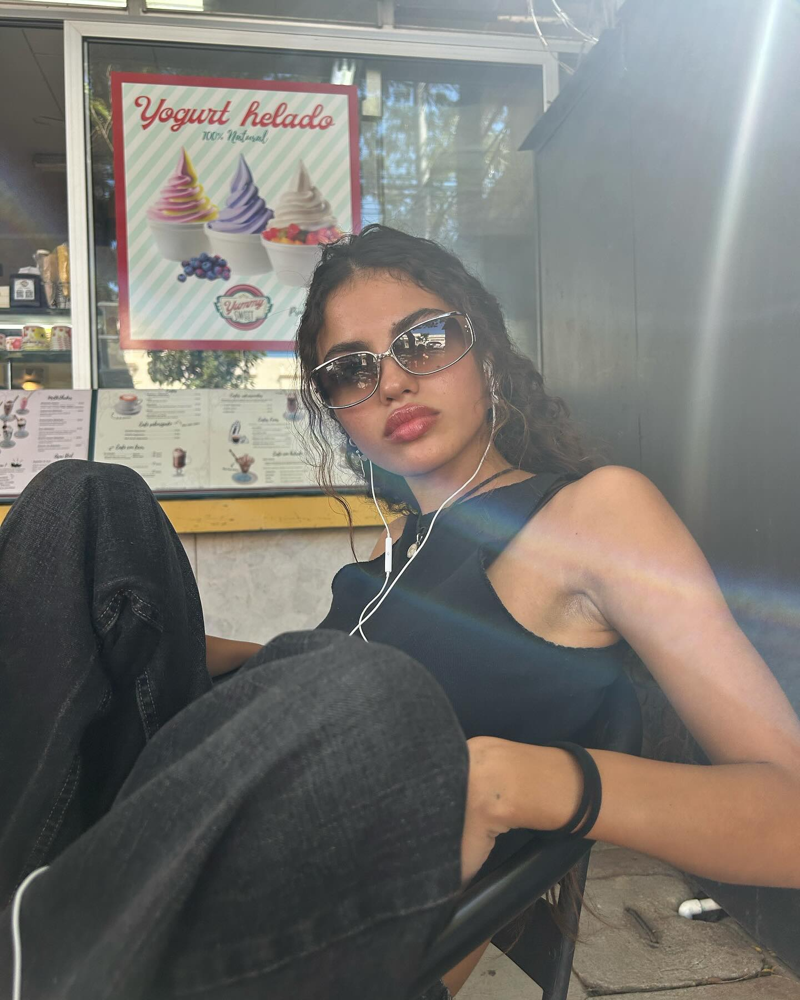

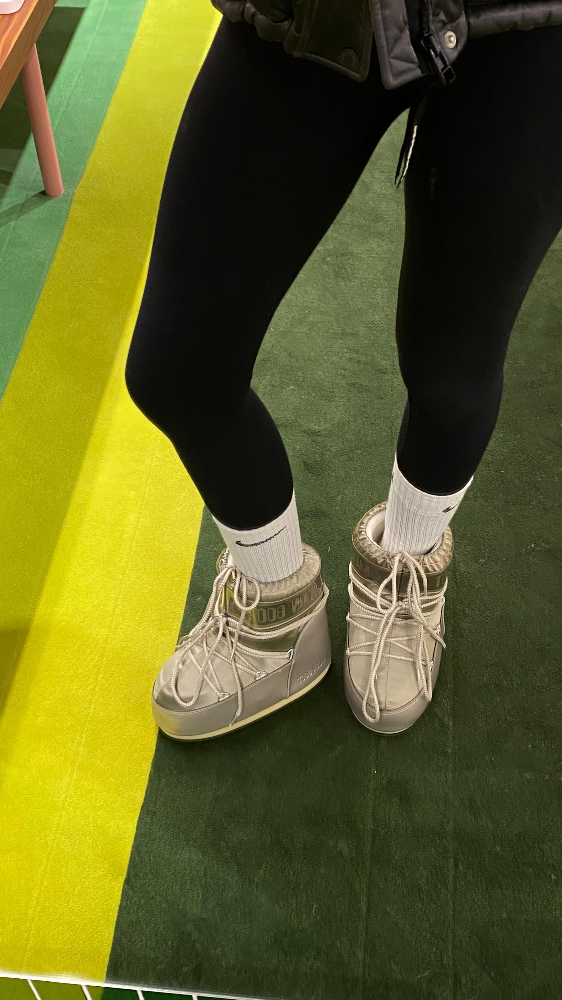

...

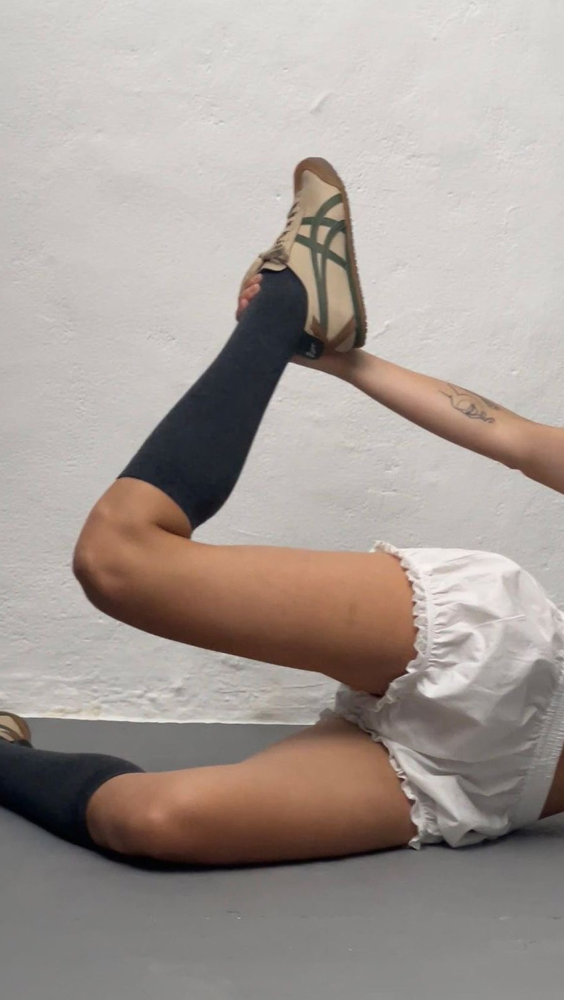

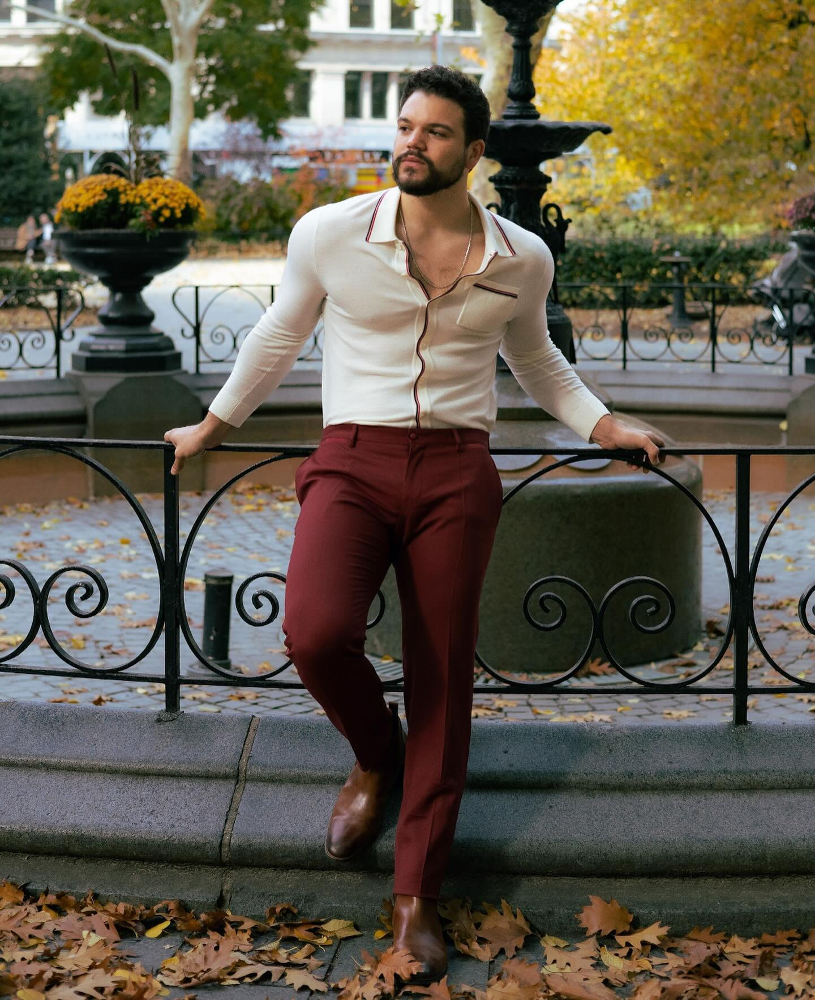

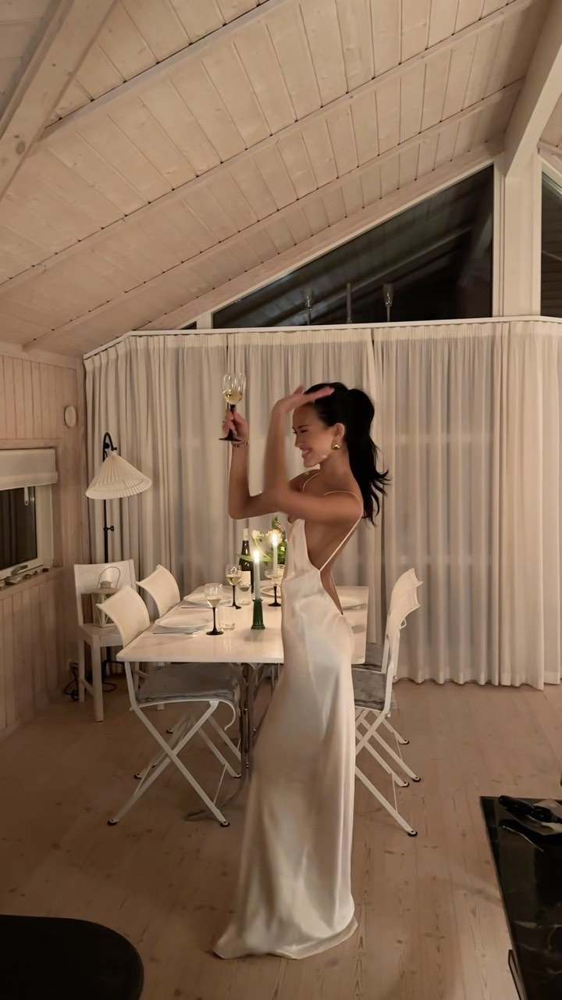

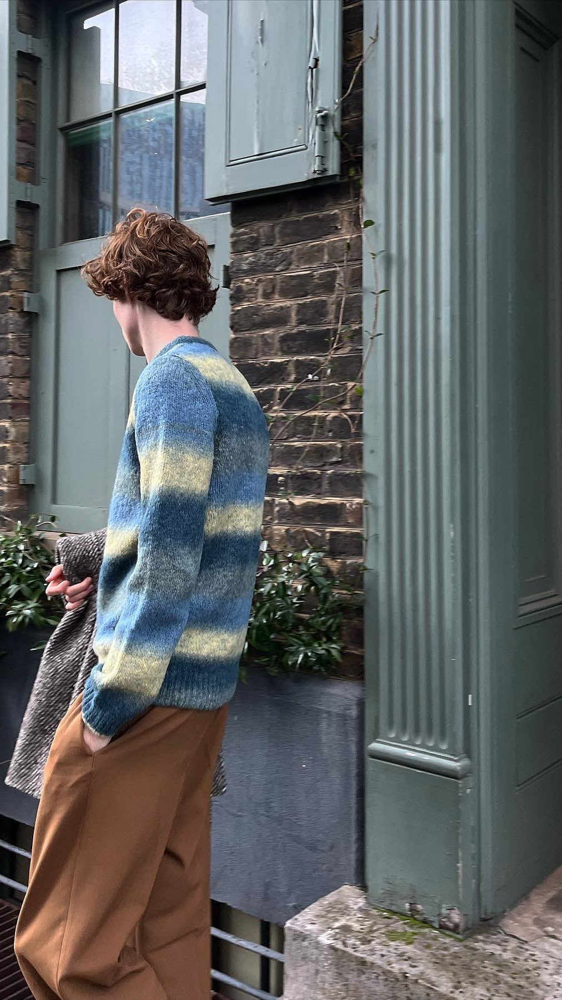

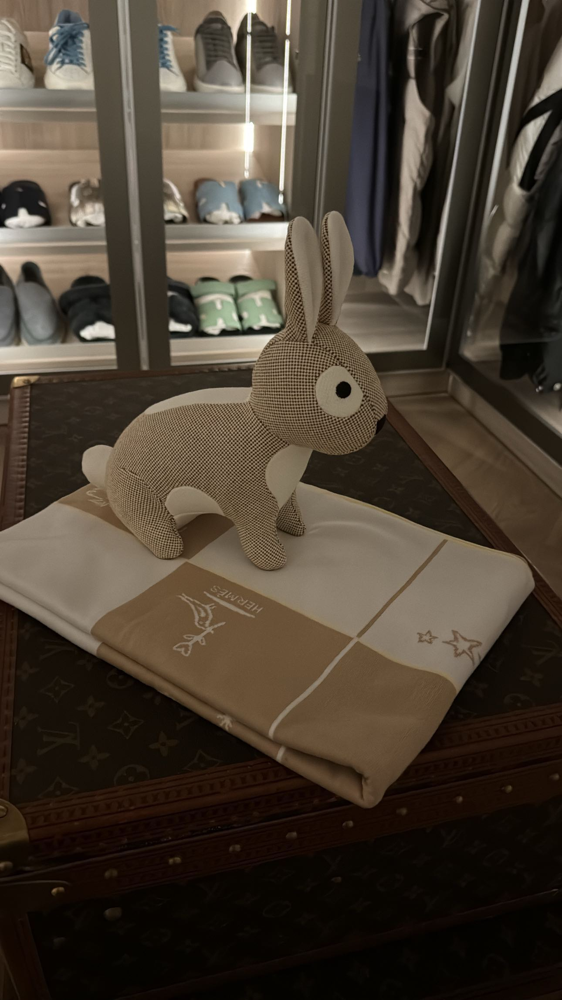

In [79]:
for image in images:
    display(image)